## Тема ноутбука: ##
### "Сравнение библиотек для задачи прогнозирования временных рядов". ###

## Введение ##

Данный доклад подготовлен и составлен в целях ознакомления о минимальных возможностях библиотек для проектирования и создания нейронных сетей на языке программирования Python, в частности для решения задач прогнозирования временных рядов.

Библиотеки можно разделить на две группы:
1. Проектированием и созданием нейронных сетей занимается программист, это те библиотеки, где есть весь минимально необходимый набор инструментов. К такой группе можно отнести tensorflow и pytorch;
2. Функционалом и проектированием моделей занимаются разработчики библиотек, это те библиотеки, где программисту необходимо правильно подготовить входные данные, настроить параметры, подобрать метрики и выстроить логику из готовых решений. К такой группе можно отнести greykite и pytorch_forecasting.

Из чего будут состоять входные данные:
* Средняя цена на приобретение строительными компаниями арматуры по Московской области в каждый месяц с промежутка начала 2000 до июля 2021 года;
* Индекс цен на приобретённый строительными организациями арматуры по Московской области, за каждый месяц указанного срока.

## Немного о теории про прогнозирование ##

__Прогнозирование__ - это одна из форм получения информации о будущем. В отличие от планов, прогнозирование позволяет лишь предвидеть ситуацию и разработать приблизительную модель поведения в будущем, основываясь на фактах прошлого. Например, успешное прогнозирование цен на строительные материалы, даёт возможность строительной компании более точно составить смету (расчёт предстоящих расходов на осуществление какой-либо деятельности) на проект.

В общем и целом, прогнозирование цен является задачей __прогнозирования временных рядов__. __Временной ряд__ - это собранные в разные моменты времени статистический материал о значении каких-либо параметров исследуемого процесса. Примерами временных рядов является:
*	Рыночные цены;
*	Объёмы продаж в торговых сетях;
*	Объёмы потребления;
*	Объёмы грузовых и пассажирских перевозок;
*	Дорожный трафик (прогнозирование пробок).

## Краткая информация о библиотеках ##

### Tensorflow ###

https://www.tensorflow.org/ - официальный сайт библиотеки tensorflow.

__Tensorflow__ - это комплексная платформа с открытым исходным кодом для машинного обучения. Он имеет всеобъемлющую гибкую экосистему инструментов, библиотек и ресурсов сообщества, которая позволяет исследователям продвигать новейшие технологии машинного обучения, а разработчикам легко создавать и развертывать приложения на основе машинного обучения.

Tensorflow позволяет довольно быстро и просто построить модель машинного с помощью интуетивно понятного и высокоуровнего API, с активных выполнением, что обеспечивает немедленную итерацию модели и простую отладку.

### PyTorch ###

https://pytorch.org/ - официальный сайт фреймворка pytorch.

__Pytorch__ - фреймворк с открытым исходным кодом для машинного обучения. Обеспечивает быстрое и гибкое экспериментирование и эффективное производство благодаря удобному интерфейсу, распределенному обучению и экосистеме инструментов и библиотек.

### Greykite ###

https://linkedin.github.io/greykite/docs/0.1.0/html/index.html - официальный сайт библиотеки Greykite.

__Greykite__ - это библиотека прогнозов, которая позволяет выполнять исследовательский анализ данных (EDA), конвейер прогнозов, настройку модели, сравнительный анализ и тд. Она включает модель Silverkite, модель прогноза, разработанную Linkedin, которая позволяет проектировать функции, автоматически обнаруживать точки изменения, отпуск эффекты, различные методы подгонки машинного обучения, диапазоны статических прогнозов и тд. Модель Silverkite имеет множество предварительно настроенных шаблонов (те. конфигураций параметров), которые подходят для различных частот прогнозов, горизонтов и шаблонов данных. Помимо Silverkite, он также включает интерфейс для модели Prophet, разработанный Facebook.

### Pytorch_forecasting ###

https://pytorch-forecasting.readthedocs.io/en/latest/ - официальный сайт библиотеки Pytorch_forecasting.

__PyTorch Forecasting__ призван упростить прогнозирование современных временных рядов с помощью нейронных сетей как для реальных случаев, так и для исследований. Цель состоит в том, чтобы предоставить высокоуровневый API с максимальной гибкостью для профессионалов и разумными настройками по умолчанию для новичков. В частности, в пакете предусмотрены:

* Класс набора данных таймсерии, который абстрагируется от обработки преобразований переменных, пропущенных значений, рандомизированной подвыборки, нескольких длин истории и тд.
* Базовый класс модели, который обеспечивает базовое обучение моделей таймсерий, а также ведение журнала в тензорной таблице и общие визуализации, такие как фактические прогнозы и графики зависимостей.
* Несколько архитектур нейронных сетей для прогнозирования временных рядов, которые были улучшены для реального развертывания и имеют встроенные возможности интерпретации
* Мульти-горизонтальные метрики таймсерий
* Оптимизатор Ranger для более быстрого обучения модели
* Настройка гиперпараметров с помощью optuna

Пакет построен на PyTorch Lightning, что позволяет обучать процессоры, один и несколько графических процессоров прямо из коробки.

## Загрузка библиотек ## 

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm import tqdm 

from sklearn.preprocessing import MinMaxScaler

## Загрузка данных ##

In [39]:
path = 'data_armature.csv'

data = pd.read_csv(path)
data['Price'] = data['Price'].astype('float')
data['Company_index'] = data['Company_index'].astype('float')

print(data.head())

      Year    Price  Company_index
0  01-2000  5662.69          129.6
1  02-2000  6581.20          116.2
2  03-2000  5570.92           84.6
3  04-2000  6405.66          115.0
4  05-2000  6359.42           99.3


## Демонстрация входных данных ##

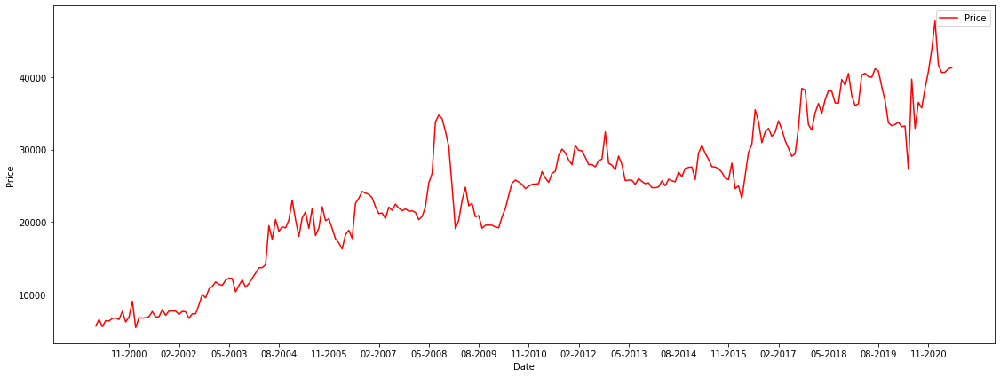

In [40]:
# отрисовка графика зависимости цены от времени.
plt.figure(figsize=(19, 7))
plt.plot(data['Year'].values, data['Price'].values, label='Price', color='red')
plt.xticks(np.arange(10, data.shape[0], 15))
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

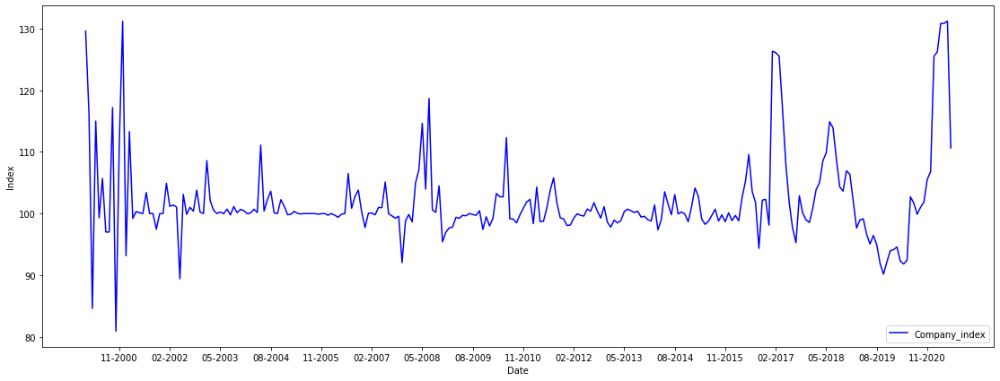

In [41]:
# отрисовка графика зависимости индексов производителей и потребителей (строительных компаний) от времени года.
plt.figure(figsize=(19, 7))
plt.plot(data['Year'].values, data['Company_index'].values, label='Company_index', color='blue')
plt.xticks(np.arange(10, data.shape[0], 15))
plt.xlabel('Date')
plt.ylabel('Index')
plt.legend()
plt.show()

## Подготовка данных ##

In [9]:
num_train = len(data) - 12  # кол-во элементов в обучающей выборке

# разделение данных для обучение и тестирования
train = data.iloc[:num_train, 1:3].values
test = data.iloc[num_train:, 1:3].values

# данные для подсчёта ошибок, при проверки моделей
all_df = data.iloc[:, 1:3].values

In [10]:
sc_price = MinMaxScaler(feature_range=(0, 1))  # переменная для масштабирования данных колонки 'Price' в диапозоне от 0 до 1
sc_company_index = MinMaxScaler(feature_range=(0, 1)) # переменная для масштабирования данных колонки 'Company_index' в диапозоне от 0 до 1

# стандартизация данных 
train_sc_price = []
train_sc_company_index = []

train_sc_price = sc_price.fit_transform(train[:, 0].reshape(-1, 1))
train_sc_company_index  = sc_company_index.fit_transform(train[:, 1].reshape(-1, 1))

# сбор данных в одну переменную
train_sc = np.hstack((train_sc_price, train_sc_company_index))

In [11]:
# стандартизация данных 
test_sc_price = []
test_sc_company_index = []

test_sc_price = sc_price.transform(test[:, 0].reshape(-1, 1))
test_sc_company_index  = sc_company_index.transform(test[:, 1].reshape(-1, 1))

# сбор даннных в одну переменную
test_sc = np.hstack((test_sc_price, test_sc_company_index))

In [12]:
window_in = 12  # окно разбиения данных на исходные и прогнозируемые
window_out = 6

In [13]:
X_train = []  
Y_train = []

# разделяем данные
for i in range(window_in, num_train - window_out):
    X_train_ = np.reshape(train_sc[i-window_in:i, :], (window_in, 2))
    X_train.append(X_train_)
    Y_train_ = np.reshape(train_sc[i:i+window_out, 0], (window_out, 1))
    Y_train.append(Y_train_)

X_train = np.stack(X_train)
Y_train = np.stack(Y_train)
print(X_train.shape)
print(Y_train.shape)

(228, 12, 2)
(228, 6, 1)


In [14]:
all_data = []
df = np.vstack((train_sc, test_sc))

for i in range(window_in, df.shape[0]):
    all_data_ = np.reshape(df[i-window_in:i, :], (window_in, 2))
    all_data.append(all_data_)

all_data = np.stack(all_data)

In [15]:
X_test = np.reshape(test_sc, (1, window_in, 2))

In [16]:
input_shape = X_train.shape[1], 2
print('input_shape={}'.format(input_shape))

input_shape=(12, 2)


## Начало работы с Tensorflow ##

In [8]:
import tensorflow as tf

from tensorflow.keras.layers import Dense, LSTM, GRU, Dropout
from tensorflow.keras.models import Sequential

## Создание модели ##

In [150]:
model_TF = Sequential()

model_TF.add(LSTM(units=64, return_sequences=True, input_shape=input_shape))
model_TF.add(LSTM(units=64))
model_TF.add(Dense(units=window_out))

model_TF.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 12, 64)            17152     
_________________________________________________________________
lstm_3 (LSTM)                (None, 64)                33024     
_________________________________________________________________
dense_1 (Dense)              (None, 6)                 390       
Total params: 50,566
Trainable params: 50,566
Non-trainable params: 0
_________________________________________________________________


## Компиляция и обучение модели ##

In [151]:
model_TF.compile(optimizer='adam', loss='mean_squared_error')
model_TF.fit(X_train, Y_train, epochs=35, batch_size=32)

Epoch 1/35
8/8 [==============================] - 0s 8ms/step - loss: 0.2628
Epoch 2/35
8/8 [==============================] - 0s 9ms/step - loss: 0.0667
Epoch 3/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0208
Epoch 4/35
8/8 [==============================] - 0s 10ms/step - loss: 0.0212
Epoch 5/35
8/8 [==============================] - 0s 9ms/step - loss: 0.0119
Epoch 6/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0119
Epoch 7/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0105
Epoch 8/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0100
Epoch 9/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0115
Epoch 10/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0109
Epoch 11/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0101
Epoch 12/35
8/8 [==============================] - 0s 8ms/step - loss: 0.0097
Epoch 13/35
8/8 [==============================] - 0s 8ms/step - loss: 0

## Тестирование модели ##

MSE: 11517486.802640583
MAE: 2476.634465907647
RMSE: 3393.7423005644646


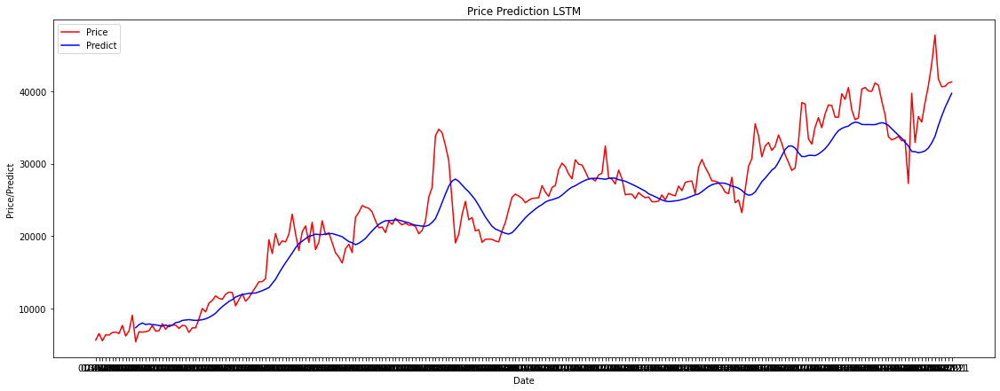

In [152]:
predict = model_TF.predict(all_data)  # предсказываем ход графика
predict = sc_price.inverse_transform(predict) # возвращаем к исходному формату значения 

diff = predict[:, 0] - all_df[-predict.shape[0]:, 0]  # ищем разницу

# высчитываем ошибки:
print("MSE:", np.mean(diff**2))
print("MAE:", np.mean(abs(diff)))
print("RMSE:", np.sqrt(np.mean(diff**2)))

# строим график, где красным показан исходный, а синим предсказанные значения
plt.figure(figsize=(19, 7))
plt.plot(data['Year'].values, data['Price'].values, label='Price', color='red')
plt.plot(data['Year'][-predict.shape[0]:].values, predict[:, 0], label='Predict', color='blue')
plt.title('Price Prediction LSTM')
plt.xlabel('Date')
plt.ylabel('Price/Predict')
plt.legend()
plt.show()

## Создание переменной с дополнительными значениями по дате ##

In [42]:
df_date = data[['Year']]

for h in range(window_out):
    df_date_add = pd.to_datetime(df_date['Year'].iloc[-1]) + pd.DateOffset(months=1)
    df_date_add = pd.DataFrame([df_date_add.strftime("%m-%Y")], columns=['Year'])
    df_date = df_date.append(df_date_add)
df_date = df_date.reset_index(drop=True)

## Предсказание ##

test.shape=(12, 2)   predict.shape=(1, 6)

 Результат:

test value: [40652.08 41121.51 41259.37]

predict value: [[39912.367 39653.61  39158.92  38241.508 39059.37  38614.13 ]]


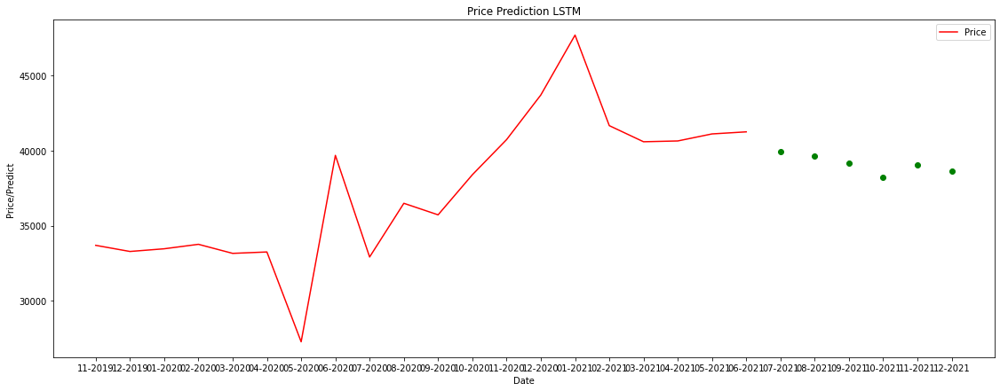

In [154]:
predict = model_TF.predict(X_test)  # предсказываем ход графика
print('test.shape={}'.format(test.shape), ' ', 'predict.shape={}'.format(predict.shape))
predict = sc_price.inverse_transform(predict) # возвращаем к исходному формату значения 

# выводим результат последние 3 значения из данных и 3 значения предсказания
print('\n Результат:')
print('\ntest value: {}'.format(test[-3:, 0]))
print('\npredict value: {}'.format(predict))

# строим график, где красным показан исходный, а синим предсказанные значения
plt.figure(figsize=(19, 7))
plt.plot(data['Year'][-20:].values, data['Price'][-20:].values, label='Price', color='red')
plt.plot(df_date['Year'][-predict.shape[1]:].values, predict.reshape(-1), 'go')
plt.title('Price Prediction LSTM')
plt.xlabel('Date')
plt.ylabel('Price/Predict')
plt.legend()
plt.show()

## PyTorch ##

In [32]:
import torch
from torch import nn

## Создание модели ##

In [33]:
class Model_LSTM(nn.Module):
    def __init__(self, input_size=2, hidden_layer_size=64, num_layers=2, output_size=6, p=0.2):
        super(Model_LSTM, self).__init__()
        
        self.n_features = input_size
        self.n_hidden = hidden_layer_size
        self.n_layers = num_layers
        self.output_size = output_size
        self.p = p
        
        self.lstm = nn.LSTM(input_size=self.n_features, 
                            hidden_size=self.n_hidden, 
                            num_layers=self.n_layers, 
                            batch_first=True)
        
        self.linear = nn.Linear(self.n_hidden, self.output_size, 6)
        
        
    def forward(self, input_seq):
        h0 = torch.zeros(self.n_layers, input_seq.size(0), self.n_hidden).requires_grad_()
        c0 = torch.zeros(self.n_layers, input_seq.size(0), self.n_hidden).requires_grad_()

        lstm_out, (hn, cn) = self.lstm(input_seq, (h0.detach(), c0.detach()))
        predictions = self.linear(lstm_out[:, -1, :])
        
        return predictions[-1]

## Подготовка переменных к дальнейшей работе ##

In [34]:
model_PT = Model_LSTM()
loss_fc = nn.MSELoss()
optimizer = torch.optim.Adam(model_PT.parameters(), lr=0.01)

epochs = 15
batch_size = 32

In [35]:
print(model_PT)

Model_LSTM(
  (lstm): LSTM(2, 64, num_layers=2, batch_first=True)
  (linear): Linear(in_features=64, out_features=6, bias=True)
)


## Обучение модели ##

In [36]:
list_predict = []

for epoch in range(epochs):
    for i in range(0, len(X_train), batch_size):
        inpt = X_train[i:i+batch_size, :, :]
        target = Y_train[i:i+batch_size]
        
        x_batch = torch.tensor(inpt, dtype=torch.float32)
        y_batch = torch.tensor(target, dtype=torch.float32)
        
        output = model_PT(x_batch)
        loss = loss_fc(output.view(-1), y_batch)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    print('Epoch: {}, loss: {}'.format(epoch, loss.item()))

Epoch: 0, loss: 0.15291038155555725
Epoch: 1, loss: 0.06084336340427399
Epoch: 2, loss: 0.05649390444159508
Epoch: 3, loss: 0.05768860876560211
Epoch: 4, loss: 0.02564007230103016
Epoch: 5, loss: 0.022403908893465996
Epoch: 6, loss: 0.028534259647130966
Epoch: 7, loss: 0.0036908043548464775
Epoch: 8, loss: 0.008357744663953781
Epoch: 9, loss: 0.00668215099722147
Epoch: 10, loss: 0.0029068351723253727
Epoch: 11, loss: 0.017599545419216156
Epoch: 12, loss: 0.011521482840180397
Epoch: 13, loss: 0.00797318946570158
Epoch: 14, loss: 0.018130216747522354


## Предсказание ##


 Результат:

test value: [40652.08 41121.51 41259.37]

predict value: [[35983.207]
 [36117.895]
 [36048.906]
 [36194.74 ]
 [35834.18 ]
 [36063.344]]


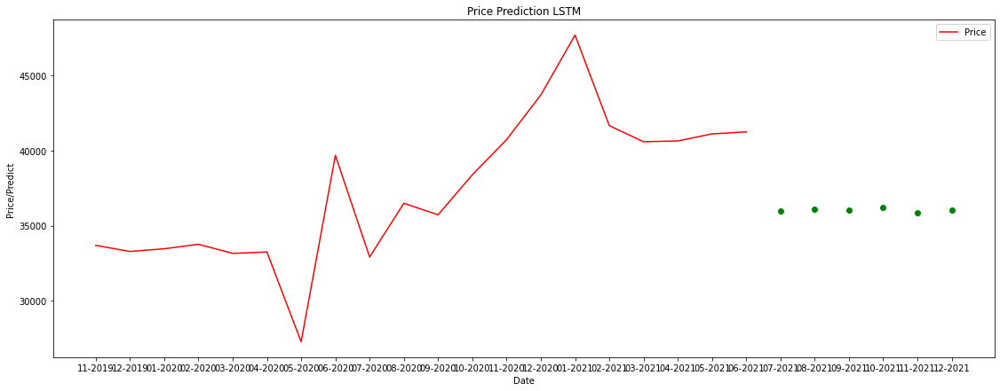

In [44]:
with torch.no_grad():
    pred_batch = torch.tensor(X_test, dtype=torch.float32)
    pred = model_PT(pred_batch)
    
predict = sc_price.inverse_transform(np.array(pred).reshape(-1, 1)) # возвращаем к исходному формату значения 

# выводим результат последние 3 значения из данных и 3 значения предсказания
print('\n Результат:')
print('\ntest value: {}'.format(test[-3:, 0]))
print('\npredict value: {}'.format(predict))

# строим график, где красным показан исходный, а синим предсказанные значения
plt.figure(figsize=(19, 7))
plt.plot(data['Year'][-20:].values, data['Price'][-20:].values, label='Price', color='red')
plt.plot(df_date['Year'][-predict.shape[0]:].values, predict.reshape(-1), 'go')
plt.title('Price Prediction LSTM')
plt.xlabel('Date')
plt.ylabel('Price/Predict')
plt.legend()
plt.show()

## Greykite ##

In [26]:
from collections import defaultdict
import warnings

warnings.filterwarnings('ignore')

import plotly
from plotly import validator_cache

from greykite.common.data_loader import DataLoader
from greykite.framework.templates.autogen.forecast_config import ForecastConfig
from greykite.framework.templates.autogen.forecast_config import MetadataParam
from greykite.framework.templates.forecaster import Forecaster
from greykite.framework.templates.model_templates import ModelTemplateEnum
from greykite.framework.utils.result_summary import summarize_grid_search_results

## Подготовка информации ##

In [72]:
df = pd.DataFrame(data)
df.rename(columns={'Year': 'ts', 'Price': 'y'}, inplace=True)
print(df.head())
print(type(df))

          ts        y  Company_index
0 2000-01-01  5662.69          129.6
1 2000-02-01  6581.20          116.2
2 2000-03-01  5570.92           84.6
3 2000-04-01  6405.66          115.0
4 2000-05-01  6359.42           99.3
<class 'pandas.core.frame.DataFrame'>


In [73]:
metadata = MetadataParam(
    time_col='ts',
    value_col='y',
    freq='MS'
)

## Запуск обучения ##

In [74]:
forecater = Forecaster()
result = forecater.run_forecast_config(
    df=df,
    config=ForecastConfig(
        model_template=ModelTemplateEnum.SILVERKITE.name,
        forecast_horizon = 6,
        coverage=0.95,
        metadata_param=metadata
    )
)

Fitting 3 folds for each of 1 candidates, totalling 3 fits


## Вывод  результата ##

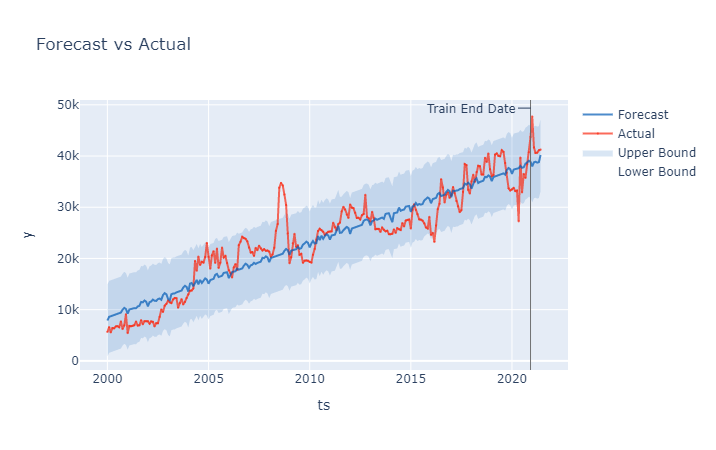

In [75]:
backtest = result.backtest
fig = backtest.plot()
plotly.io.show(fig)

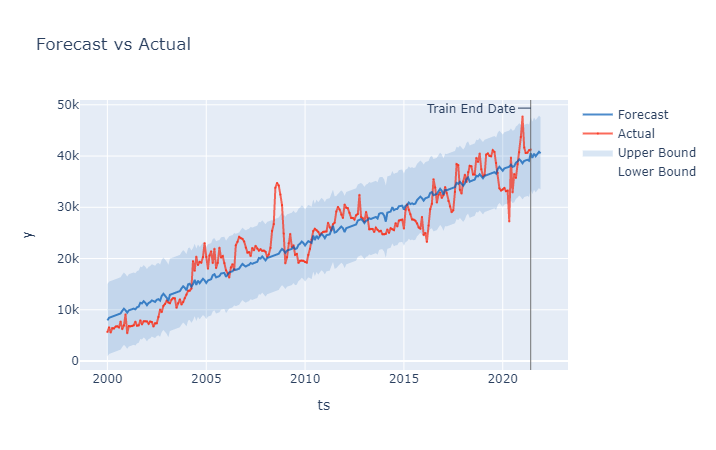

In [76]:
forecast = result.forecast
fig = forecast.plot()
plotly.io.show(fig)

## Pytorch-Forecating ## 


In [72]:
import torch
import torch.nn as nn

import pytorch_lightning as pl
from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor

from pytorch_forecasting import TimeSeriesDataSet, TemporalFusionTransformer
from pytorch_forecasting.metrics import SMAPE, PoissonLoss, QuantileLoss

import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile

import warnings
warnings.filterwarnings('ignore')

## Подготовка данных, добавление новых столбов ##

In [73]:
data_for_pf = pd.read_csv('data_armature.csv', parse_dates=['Year'])

data_for_pf['time_idx'] = [x for x in range(len(data_for_pf))]
data_for_pf['group'] = [0 for _ in range(len(data_for_pf))]

data_for_pf['month'] = data_for_pf['Year'].dt.month.astype(str).astype('category')

print(data_for_pf.head())

        Year    Price  Company_index  time_idx  group month
0 2000-01-01  5662.69          129.6         0      0     1
1 2000-02-01  6581.20          116.2         1      0     2
2 2000-03-01  5570.92           84.6         2      0     3
3 2000-04-01  6405.66          115.0         3      0     4
4 2000-05-01  6359.42           99.3         4      0     5


## Создание набора обучающих данных ##

In [74]:
# define dataset
max_encoder_length = 12
max_prediction_length = 6
training_cutoff = data_for_pf["time_idx"].max() - max_prediction_length

training = TimeSeriesDataSet(
    data_for_pf[lambda x: x.time_idx <= training_cutoff],
    time_idx='time_idx',
    target='Price',
    group_ids=['group'],
    max_encoder_length=max_encoder_length,
    max_prediction_length=max_prediction_length,
    static_reals=['Company_index'],
    time_varying_known_categoricals=['month'],
    time_varying_known_reals=['time_idx'],
    time_varying_unknown_categoricals=[],
    time_varying_unknown_reals=['Company_index'],
)

## Создание набора данных для проверки ##

In [75]:
# create validation and training dataset
validation = TimeSeriesDataSet.from_dataset(training, data_for_pf, min_prediction_idx=training.index.time.max() + 1, stop_randomization=True)
batch_size = 128
train_dataloader = training.to_dataloader(train=True, batch_size=batch_size, num_workers=2)
val_dataloader = validation.to_dataloader(train=False, batch_size=batch_size, num_workers=2)

## Создание экземпляра модели ##

In [81]:
# define trainer with early stopping
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=1, verbose=False, mode="min")
lr_logger = LearningRateMonitor()
trainer = pl.Trainer(
    max_epochs=100,
    gpus=0,
    gradient_clip_val=0.1,
    limit_train_batches=30,
    callbacks=[lr_logger, early_stop_callback],
)


# create the model
tft = TemporalFusionTransformer.from_dataset(
    training,
    learning_rate=0.03,
    hidden_size=32,
    attention_head_size=1,
    dropout=0.1,
    hidden_continuous_size=16,
    output_size=7,
    loss=QuantileLoss(),
    log_interval=2,
    reduce_on_plateau_patience=4
)
print(f"Number of parameters in network: {tft.size()/1e3:.1f}k")

GPU available: True, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Number of parameters in network: 62.5k


## Поиск оптимальной скорости обучения ##


   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 72    
3  | prescalers                         | ModuleDict                      | 64    
4  | static_variable_selection          | VariableSelectionNetwork        | 1.8 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 4.0 K 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.1 K 
7  | static_context_variable_selection  | GatedResidualNetwork            | 4.3 K 
8  | static_context_initial_hidden_lstm | GatedResidualNetwork            | 4.3 K 
9  | static_context_initial_cell_lstm   | GatedResidualNetwork            | 4.3 

Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 VALIDATE RESULTS
{'val_MAE': 13083.3251953125,
 'val_MAPE': 0.3501810133457184,
 'val_RMSE': 14389.6669921875,
 'val_SMAPE': 0.4421861469745636,
 'val_loss': 7125.89892578125}
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
DATALOADER:0 VALIDATE RESULTS
{'val_MAE': 13083.3251953125,
 'val_MAPE': 0.3501810133457184,
 'val_RMSE': 14389.6669921875,
 'val_SMAPE': 0.4421861469745636,
 'val_loss': 7125.89892578125}
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
DATALOADER:0 VALIDATE RESULTS
{'val_MAE': 13083.3251953125,
 'val_MAPE': 0.3501810133457184,
 'val_RMSE': 14389.6669921875,
 'val_SMAPE': 0.4421861469745636,
 'val_loss': 7125.89892578125}
----------------------------

Restoring states from the checkpoint file at /home/jovyan/work/notebooks/Comparison_of_libraries/lr_find_temp_model.ckpt
Restored all states from the checkpoint file at /home/jovyan/work/notebooks/Comparison_of_libraries/lr_find_temp_model.ckpt


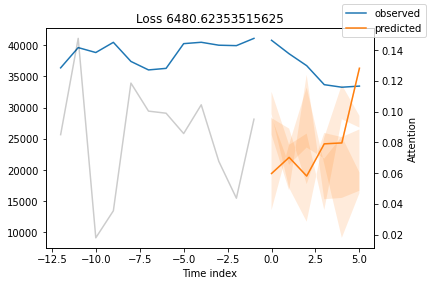

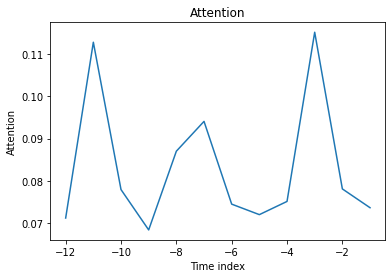

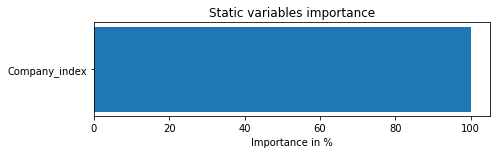

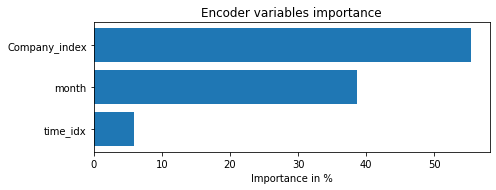

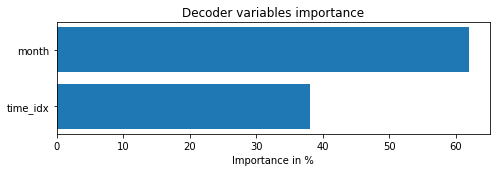

...

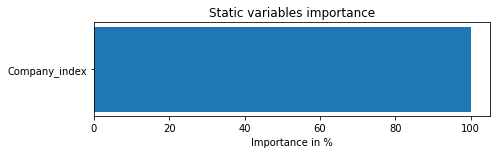

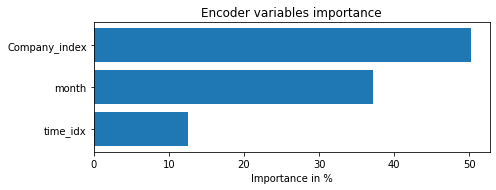

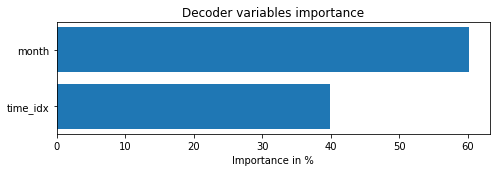

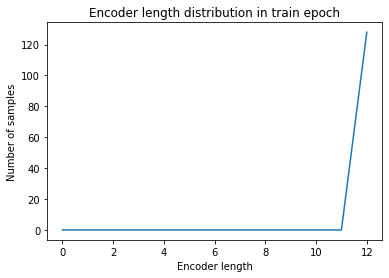

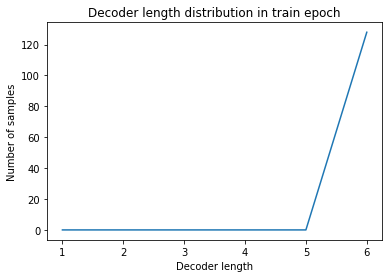

In [82]:
# find optimal learning rate (set limit_train_batches to 1.0 and log_interval = -1)
res = trainer.tuner.lr_find(
    tft, train_dataloader=train_dataloader, val_dataloaders=val_dataloader, early_stop_threshold=1000.0, max_lr=0.3,
)

suggested learning rate: 0.04514793765986135


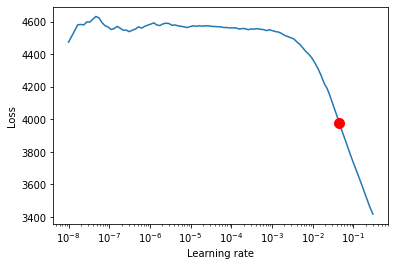

In [83]:
print(f"suggested learning rate: {res.suggestion()}")
fig = res.plot(show=True, suggest=True)
fig.show()

## Обучение модели с ранней остановкой на обучающем наборе данных. Предсказание значений ##

In [84]:
# fit the model
trainer.fit(
    tft, train_dataloader=train_dataloader, val_dataloaders=val_dataloader,
)


   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 72    
3  | prescalers                         | ModuleDict                      | 64    
4  | static_variable_selection          | VariableSelectionNetwork        | 1.8 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 4.0 K 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.1 K 
7  | static_context_variable_selection  | GatedResidualNetwork            | 4.3 K 
8  | static_context_initial_hidden_lstm | GatedResidualNetwork            | 4.3 K 
9  | static_context_initial_cell_lstm   | GatedResidualNetwork            | 4.3 

Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [85]:
# load the best model according to the validation loss
# (given that we use early stopping, this is not necessarily the last epoch)
best_model_path = trainer.checkpoint_callback.best_model_path
best_tft = TemporalFusionTransformer.load_from_checkpoint(best_model_path)

In [86]:
# calcualte mean absolute error on validation set
actuals = torch.cat([y[0] for x, y in iter(val_dataloader)])
predictions = best_tft.predict(val_dataloader)
(actuals - predictions).abs().mean()

tensor(11833.0166)

In [87]:
# raw predictions are a dictionary from which all kind of information including quantiles can be extracted
raw_predictions, x = best_tft.predict(val_dataloader, mode="raw", return_x=True)

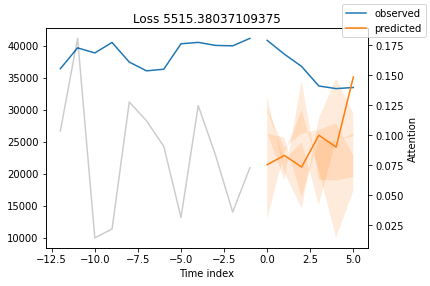

In [88]:
# for idx in range(10):  # plot 10 examples
best_tft.plot_prediction(x, raw_predictions, idx=0, add_loss_to_title=True);

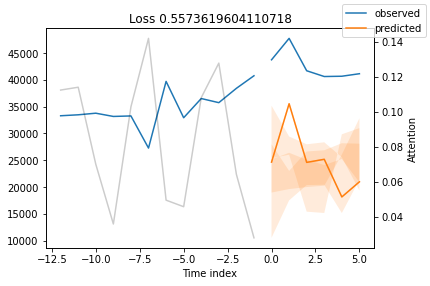

In [89]:
# calcualte metric by which to display
predictions = best_tft.predict(val_dataloader)
mean_losses = SMAPE(reduction="none")(predictions, actuals).mean(1)
indices = mean_losses.argsort(descending=True)  # sort losses
# for idx in range(10):  # plot 10 examples
best_tft.plot_prediction(
    x, raw_predictions, idx=indices[0], add_loss_to_title=SMAPE(quantiles=best_tft.loss.quantiles)
);

{'attention': <Figure size 432x288 with 1 Axes>,
 'static_variables': <Figure size 504x162 with 1 Axes>,
 'encoder_variables': <Figure size 504x198 with 1 Axes>,
 'decoder_variables': <Figure size 504x180 with 1 Axes>}

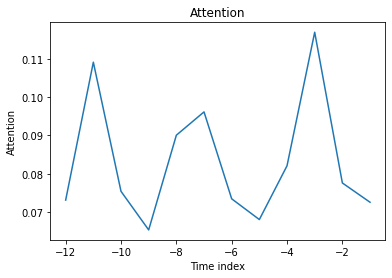

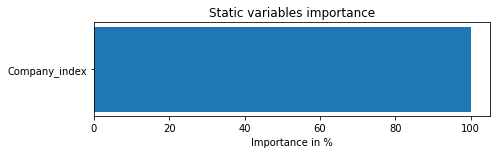

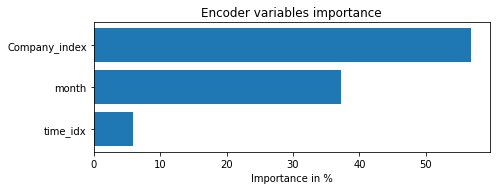

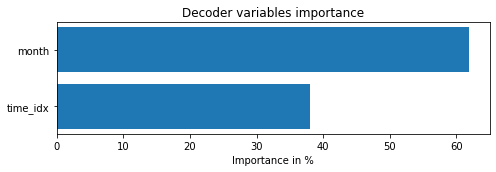

In [90]:
interpretation = best_tft.interpret_output(raw_predictions, reduction="sum")
best_tft.plot_interpretation(interpretation)

## Вывод ##

Исходя из проделанной работы и собранного материала можно сказать, что каждая библиотека имеет свои плюсы и минусы, разные по написанию кода и проектирования моделей и логики.
Поэтому говорить что-то общее нету смысла и оценивать стоит каждую по отдельности.

Критерии оценивания библиотек:
1. Порог вхождения;
2. Визуализация и удобность в проектировании модели;
3. Оталдка кода и внутренних значений;
4. Виды решаемых задач.

__Tensorflow__:
1. Библиотека достаточно проста в освоении так как имеет понятный интерфейс, множество туториалов и видео уроков. Также имеет понятную документацию;
2. Библиотека имеет достаточно интуетивно понятное и высокоуровневое API, что позволяет довольно быстро и качественно составить программу;
3. Из-за упрощённой визуализации практически невозможно следить за ходом выполнения обучения предсказывание модели нейронной сетии и одновременно, это является плюсом в отладке кода, но не внутренних значений;
4. Библиотека позволяет решать множество задач, например, как работа с видео, аудио данными, изображениями, времяными рядами и множество другое.

Tensorflow идеально подходит для программистов начального уровня, позволяющая в кратчайшие сроки овладеть минимальными навыками в создании нейронных сетей.

__PyTorch__:
1. Фреймворк имеет обширную документацию, большое колличество видео уроков и сообществ;
2. PyTorch довольно сильно отличается в визуализации от Tensorflow. Здесь приходится прописывать всю логику программы практически самостоятельно;
3. В фреймворке отслеживать можно практически всё, что является большим преимуществом при отладки кода и внутренных значений моделей;
4. Pytorch также как Tensorflow является многофункциональным и решает множество задач.

PyTorch подходит для создания более сложных моделей и программисту начального уровня будет трудно в самом начале.

__Greykite__:
1. Greykite удобный и простой инструммент для решения задач на временные ряды. Имеет качественную документацию и хорошую поддержку со стороны разработчикаж
2. Самый простой интерфейс, где разработчик библиотеки позаботился практически обо всём;
3. Так как это готовый инструмент, ошибки в коде довольно трудно получить. Отслеживать и менять внутренние значения практически не возможно;
4. Greykity специализируется только на решении задач временных рядов.
Greykite лёгок в освоении и является быстрым решением для задач временных рядов.

__Pytorch_forecasting__:

1. Библиотека является трудным и не однозначным инструментом для решения задач на времяные ряды. Имеет не большую документацию и практически не имеет практических примеров;
2. Сложный интерфейс, с множеством настроек и сильно похожий на PyTorch;
3. Также как в фреймворкке PyTorch;
4. Специализируется на задаче решения временных рядов сразличной классификацией.

Pytorch_forecasting является одной из самых трудных библиотек в освоении и подходит для программистов среднего и более уровня.